In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
import matplotlib.pylab as pylab
import cartopy.feature as cfeature
import scipy.stats as stats
import xarray as xr
import pdb
import glob
import itertools
import numpy.ma as ma
import salem


pylab.rcParams['figure.figsize'] = (50., 50.)
%matplotlib inline

In [1]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


Read the different file types: pb-tags indicate pressure level files, pc-tags indicate pure surface files.
Past is 1980 vegetation, current is 2010. 
Topography and vegetation information is saved in ancillaries folder 'ancils'.

In [156]:
VERA_data_dir = '/media/ck/LStorage/global_water/other/Marian/LAI_experiments/'
new_path = '/home/ck/DIR/cornkle/data/Marian/'

wrf_in_green = '/media/ck/LStorage/global_water/other/Marian/LAI_experiments/green/wrfinput_d01'
wrf_in_brown = '/media/ck/LStorage/global_water/other/Marian/LAI_experiments/brown/wrfinput_d01'
day1_diff_2000 = new_path+ 'wrf_diff_greenBrown_*_2002.nc'

day1_diff_2011 = new_path+ 'wrf_diff_greenBrown_*_2011.nc'

In [182]:
wrfg = salem.open_wrf_dataset(wrf_in_green).isel(south_north=slice(0,200), west_east=slice(50,350))
wrfb = salem.open_wrf_dataset(wrf_in_brown).isel(south_north=slice(0,200), west_east=slice(50,350))
diff = xr.open_mfdataset(day1_diff_2000, concat_dim='time', combine='nested')#.groupby('time.hour').mean('time') #xr.open_mfdataset(day1_diff_2000, concat_dim='days', combine='nested').groupby('time.day').mean('days')
diff = diff.assign_coords({'lon' : wrfg.lon, 'lat' : wrfg.lat})
diff = diff.isel(south_north=slice(0,200), west_east=slice(50,350))


diff11 = xr.open_mfdataset(day1_diff_2011, concat_dim='time', combine='nested')#.groupby('time.hour').mean('time') #xr.open_mfdataset(day1_diff_2000, concat_dim='days', combine='nested').groupby('time.day').mean('days')
diff11 = diff11.assign_coords({'lon' : wrfg.lon, 'lat' : wrfg.lat})
diff11 = diff11.isel(south_north=slice(0,200), west_east=slice(50,350))

In [174]:
diff = diff.rename({'hour' : 'time'})
diff11 = diff11.rename({'hour' : 'time'})

In [171]:
diff

<xarray.Dataset>
Dimensions:      (south_north: 200, west_east: 300, time: 8, bottom_top: 44,
                  soil_layers: 3)
Coordinates:
    lat          (south_north, west_east) float32 10.22 10.22 ... 19.41 19.41
    lon          (south_north, west_east) float32 -17.68 -17.63 ... -3.369
  * west_east    (west_east) float64 -1.742e+06 -1.738e+06 ... -2.475e+05
  * south_north  (south_north) float64 1.073e+06 1.078e+06 ... 2.068e+06
  * time         (time) int64 0 3 6 9 12 15 18 21
Dimensions without coordinates: bottom_top, soil_layers
Data variables: (12/48)
    ALBEDO       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LH           (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    HFX          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    OLR          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    PBLH         (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    PSFC         (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    ...           ...
    SHDMIN       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    VEGFRA       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LANDMASK     (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LU_INDEX     (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    IVGTYP       (time, south_north, west_east) float64 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    HGT          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>

In [51]:
def u_v_to_ws_wd(u,v):
    """
    This function computes wind speed and wind direction from given u,v wind components
    Wind direction indicates where the wind is coming from. 
    :param u:
    :param v:
    :return: tuple (wind speed, wind direction (convention "wind coming from")
    """

    ws = np.array(np.sqrt(u*u + v*v))
    wd = np.array(180. + np.arctan2(u, v) * 180./ np.pi)  # dir where wind is coming from
    pos = np.where(ws == 0)
    try:
        wd[pos] = np.nan
    except IndexError:
        pass

    return ws,wd

In [52]:
ucur = diff['U10']   # data for wind example
vcur = diff['V10']

In [42]:
## a clean way of plotting - use matplotlib functions directly:

def draw_map(ax, data, lon, lat, title=None,  mask_sig=None, quiver=None, contour=None, cbar_label=None, **kwargs):

    mapp = ax.contourf(lon, lat, data, transform=ccrs.PlateCarree(), **kwargs)  # this is the actual plot
    
    ## mask for significance indicator
    if mask_sig is not None:
         plt.contourf(lon, lat, mask_sig, colors='none', hatches='.',
                     levels=[0.5, 1], linewidth=0.1)
    
    ## quiver list
    if quiver is not None:
        qu = ax.quiver(quiver['x'], quiver['y'], quiver['u'], quiver['v'], scale=quiver['scale'])
    ## additional contour on plot   
    if contour is not None:
        ax.contour(contour['x'], contour['y'], contour['data'], levels=contour['levels'], cmap=contour['cmap'], linewidths=0.5 )
        
    
    ax.coastlines()   ## adds coastlines
    # Gridlines
    xl = ax.gridlines(draw_labels=True);   # adds latlon grid lines
    xl.xlabels_top = False   ## labels off
    xl.ylabels_right = False
    plt.title(title)
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--'); # adds country borders
    cbar = plt.colorbar(mapp)  # adds colorbar
    cbar.set_label(cbar_label)
  

In [43]:
import matplotlib.patches as patches
def draw_map_pixel(ax, t, lat, lon, title='', clabel='', cmap='RdBu_r', **kwargs):
    
    plt.pcolormesh(lon, lat, t, transform=ccrs.PlateCarree(), cmap=cmap, **kwargs)
    ax.coastlines()
    
    
    # Gridlines
    xl = ax.gridlines(draw_labels=True, linewidth=0.5, color='grey', linestyle='dashed');
    #ax.set_xticks(np.arange(-140,161,20), minor=True)
    plt.grid(which='minor')
    
    xl.top_labels = False
    xl.right_labels = False
    xl.xlines = False
    xl.ylines=False
    # Countries
    #ax.add_feature(cartopy.feature.BORDERS, linestyle='--', color='grey', linewidth=0.5);
    
    #rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=0.8,edgecolor='w',facecolor='none', zorder=99)
        
    #ax.add_patch(rect2)
    
    plt.title(title)
    cbar = plt.colorbar()
    cbar.set_label(clabel)

In [44]:
from utils import u_plot
norm = u_plot.discrete_cmap_norm([-1,1,10], 'jet')

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

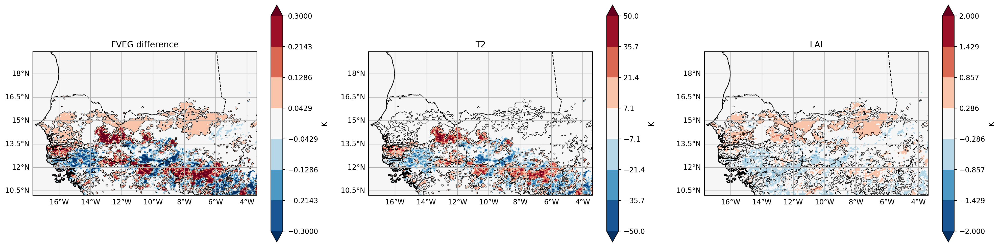

In [229]:
lon=diff11.lon
lat=diff11.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(131, projection=ccrs.PlateCarree())
time_id = 1
data2=diff11['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='FVEG difference'
draw_map(ax , data2, lon, lat, title=title, levels=np.linspace(-0.3,0.3,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')

ax = f.add_subplot(132, projection=ccrs.PlateCarree())
time_id = 1
data=diff11['VEGFRA'].isel(time=time_id)
data2=diff11['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='T2'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(133, projection=ccrs.PlateCarree())
time_id = 5
data=diff11['LAI'].isel(time=time_id)
data2=diff11['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='LAI'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall diff11erences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

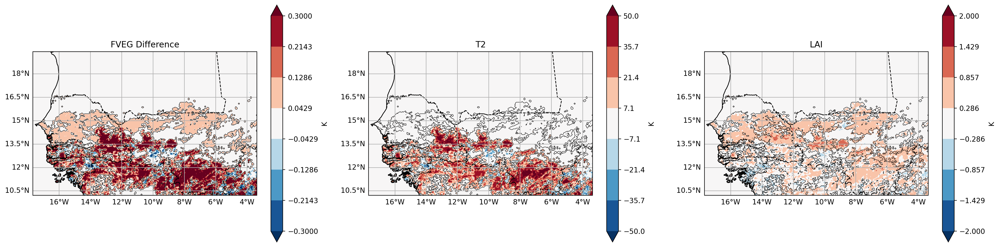

In [226]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(131, projection=ccrs.PlateCarree())
time_id = 1
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='FVEG Difference'
draw_map(ax , data2, lon, lat, title=title, levels=np.linspace(-0.3,0.3,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')

ax = f.add_subplot(132, projection=ccrs.PlateCarree())
time_id = 1
data=diff['VEGFRA'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='T2'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(133, projection=ccrs.PlateCarree())
time_id = 5
data=diff['LAI'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='LAI'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

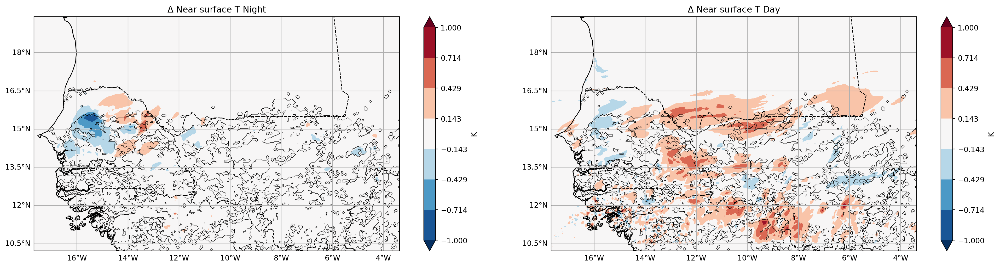

In [258]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())
time_id = 1
data=diff['T'].isel(time=time_id, bottom_top=4)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ Near surface T Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-1,1,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(122, projection=ccrs.PlateCarree())
time_id = 4
data=diff['T'].isel(time=time_id, bottom_top=4)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ Near surface T Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-1,1,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

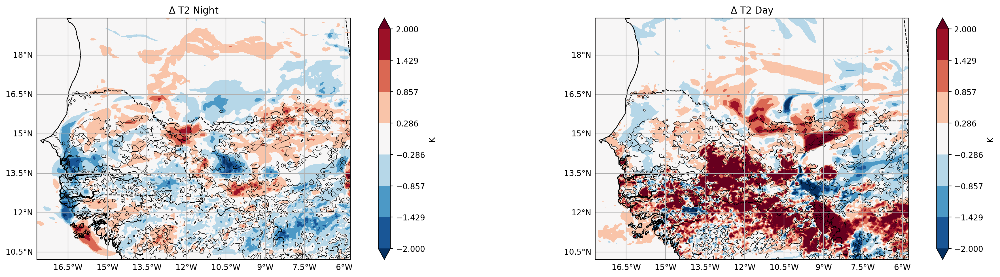

In [26]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())
time_id = 1
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ T2 Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(122, projection=ccrs.PlateCarree())
time_id = 4
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ T2 Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

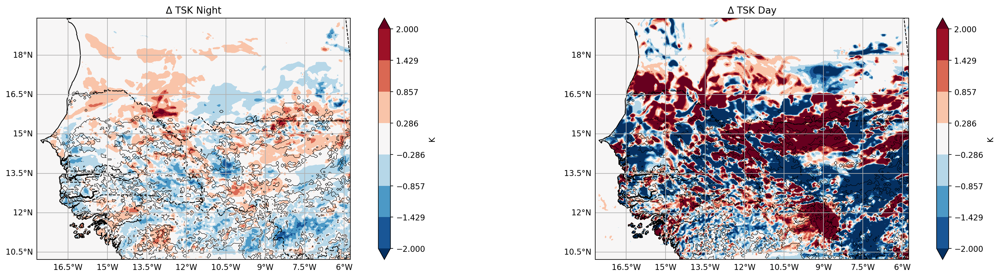

In [27]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())
time_id = 1
data=diff['TSK'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ TSK Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(122, projection=ccrs.PlateCarree())
time_id = 4
data=diff['TSK'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ TSK Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

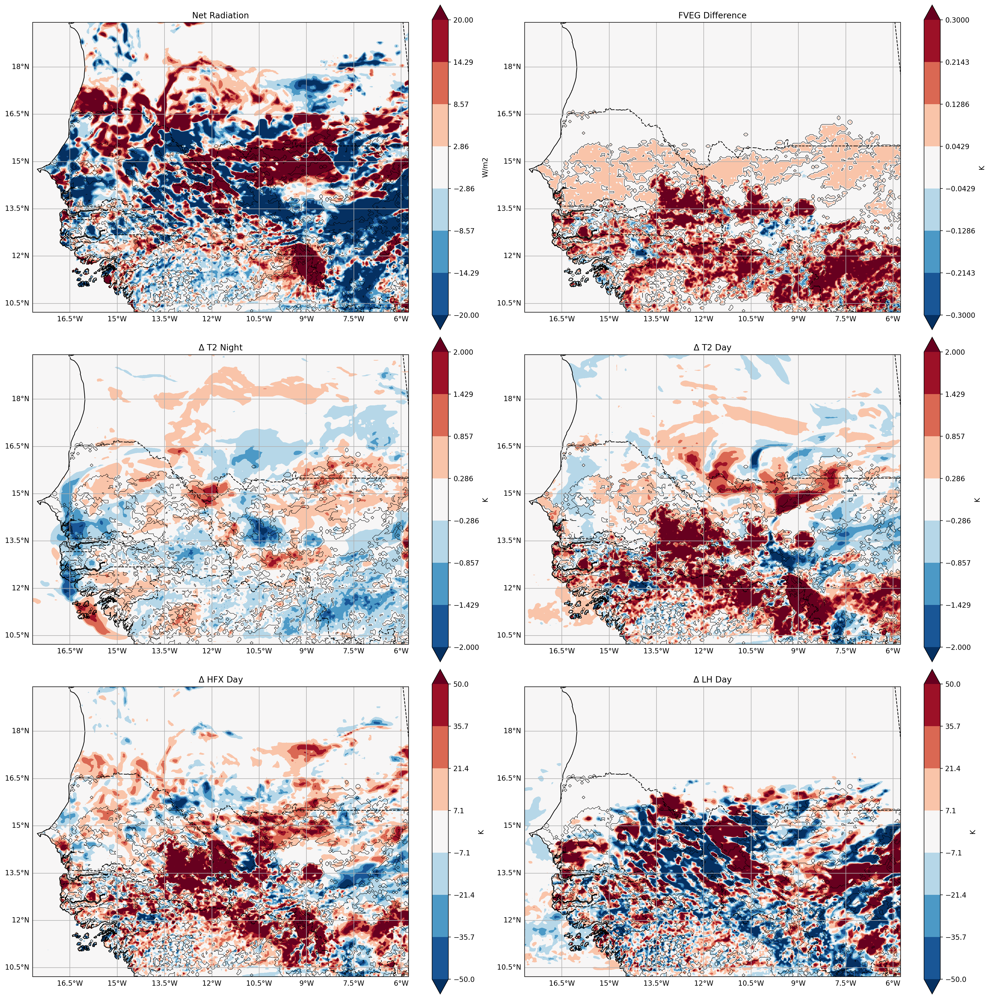

In [28]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,20), dpi=200)

ax = f.add_subplot(321, projection=ccrs.PlateCarree())
time_id = 4
data= diff['LWUPB'].isel(time=time_id) #diff['LWDNB'].isel(time=time_id)  #diff['SWDNB'].isel(time=time_id) - diff['SWUPB'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'Net Radiation'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-20,20,8), extend='both', cmap='RdBu_r', cbar_label= 'W/m2', contour=contour)

#ax.contour(lon, lat, diff['FVEG'].isel(time=4), levels=[-50,0.1], colors='k')

ax = f.add_subplot(322, projection=ccrs.PlateCarree())
time_id = 1
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='FVEG Difference'
draw_map(ax , data2, lon, lat, title=title, levels=np.linspace(-0.3,0.3,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(323, projection=ccrs.PlateCarree())
time_id = 1
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ T2 Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(324, projection=ccrs.PlateCarree())
time_id = 4
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ T2 Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

ax = f.add_subplot(325, projection=ccrs.PlateCarree())
time_id = 4
data=diff['HFX'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ HFX Day'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(326, projection=ccrs.PlateCarree())
time_id = 4
data=diff['LH'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ LH Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

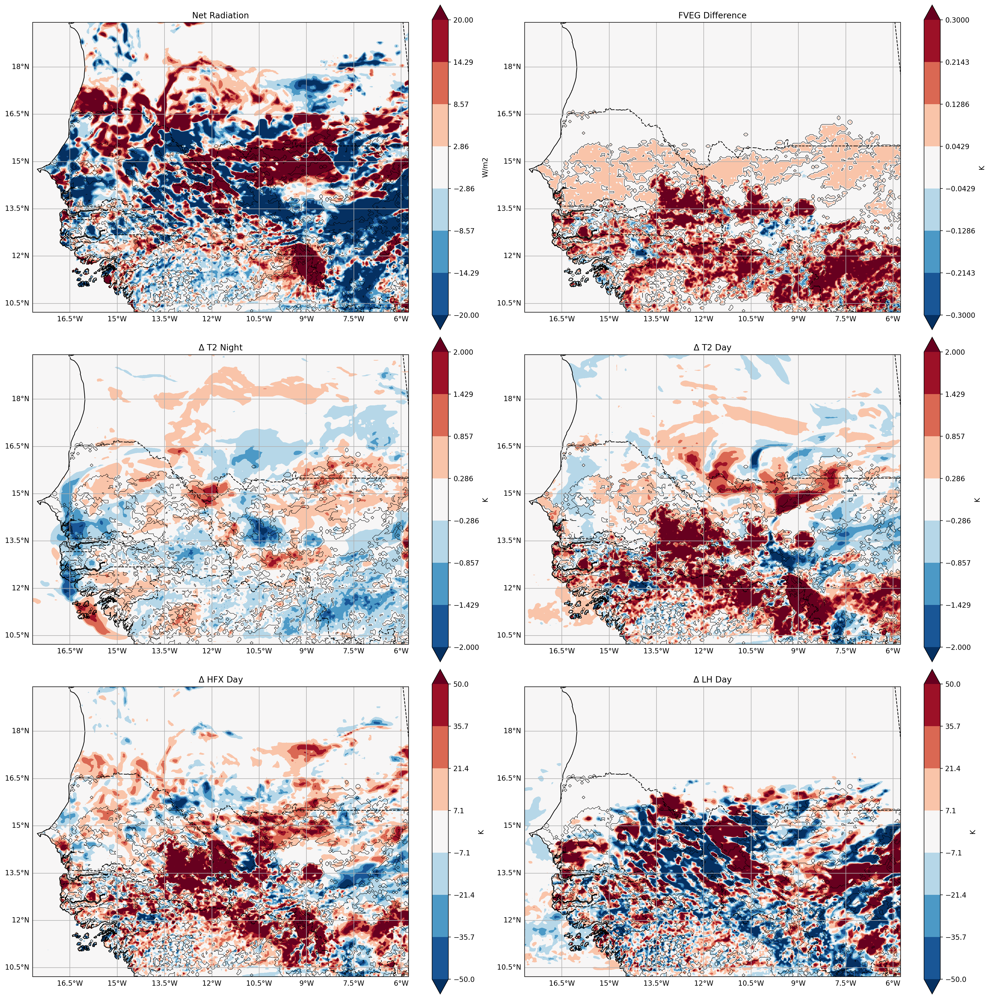

In [29]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,20), dpi=200)

ax = f.add_subplot(321, projection=ccrs.PlateCarree())
time_id = 4
data= diff['LWUPB'].isel(time=time_id) #diff['LWDNB'].isel(time=time_id)  #diff['SWDNB'].isel(time=time_id) - diff['SWUPB'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'Net Radiation'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-20,20,8), extend='both', cmap='RdBu_r', cbar_label= 'W/m2', contour=contour)

#ax.contour(lon, lat, diff['FVEG'].isel(time=4), levels=[-50,0.1], colors='k')

ax = f.add_subplot(322, projection=ccrs.PlateCarree())
time_id = 1
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title='FVEG Difference'
draw_map(ax , data2, lon, lat, title=title, levels=np.linspace(-0.3,0.3,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(323, projection=ccrs.PlateCarree())
time_id = 1
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ T2 Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(324, projection=ccrs.PlateCarree())
time_id = 4
data=diff['T2'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ T2 Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

ax = f.add_subplot(325, projection=ccrs.PlateCarree())
time_id = 4
data=diff['HFX'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ HFX Day'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(326, projection=ccrs.PlateCarree())
time_id = 4
data=diff['LH'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ LH Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-50,50,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

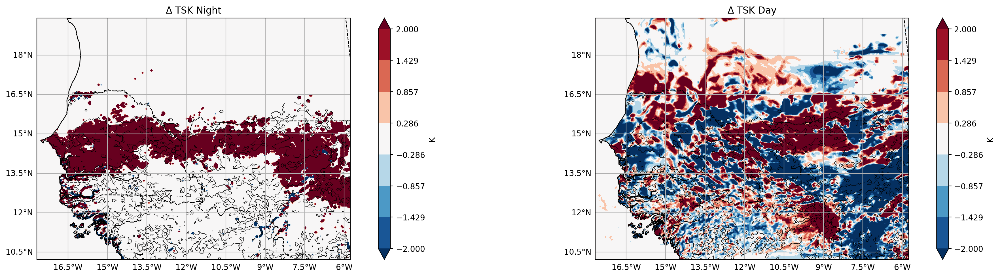

In [30]:
lon=diff.lon
lat=diff.lat
f = plt.figure(figsize=(20,5), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())
time_id = 1
data=diff['SHDMAX'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

title=r'$\Delta$ TSK Night'
draw_map(ax, data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')


ax = f.add_subplot(122, projection=ccrs.PlateCarree())
time_id = 4
data=diff['TSK'].isel(time=time_id)
data2=diff['FVEG'].isel(time=time_id)

contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' :[-50,0], 'cmap' : 'Greys'}

title='$\Delta$ TSK Day'
draw_map(ax , data, lon, lat, title=title, levels=np.linspace(-2,2,8), extend='both', cmap='RdBu_r', contour=contour, cbar_label= 'K')
## Note that rainfall differences are very noisy!
## Note also that we barely get any rainfall at all (current or past!) in the deforestation region in our simulations..
plt.tight_layout()

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

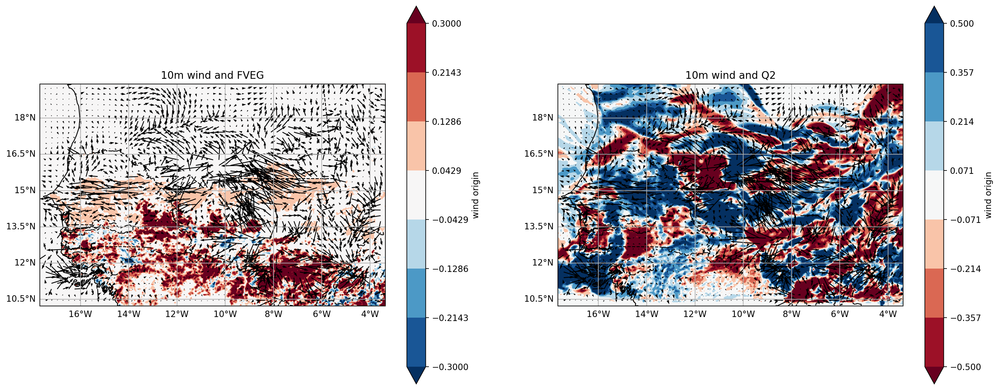

In [53]:
# preparation of wind vector data in plot
st=5
sarrow = 5

time_id = 4

xquiv = diff.lon[sarrow::st, sarrow::st]
yquiv = diff.lat[sarrow::st, sarrow::st]

uu = (ucur.isel(time=time_id))[sarrow::st, sarrow::st]
vv = (vcur.isel(time=time_id))[sarrow::st, sarrow::st]

f = plt.figure(figsize=(20,8), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())

data=diff['FVEG'].isel(time=time_id)

qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}

draw_map(ax, data, diff.lon, diff.lat, title='10m wind and FVEG', quiver=qin, levels=np.linspace(-0.3,0.3,8), cbar_label='wind origin', cmap='RdBu_r', extend='both')

ax = f.add_subplot(122, projection=ccrs.PlateCarree())

data=diff['Q2'].isel(time=time_id)*1000

qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}

draw_map(ax, data, diff.lon, diff.lat, title='10m wind and Q2', quiver=qin, levels=np.linspace(-0.5,0.5,8), cbar_label='wind origin', cmap='RdBu', extend='both')

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

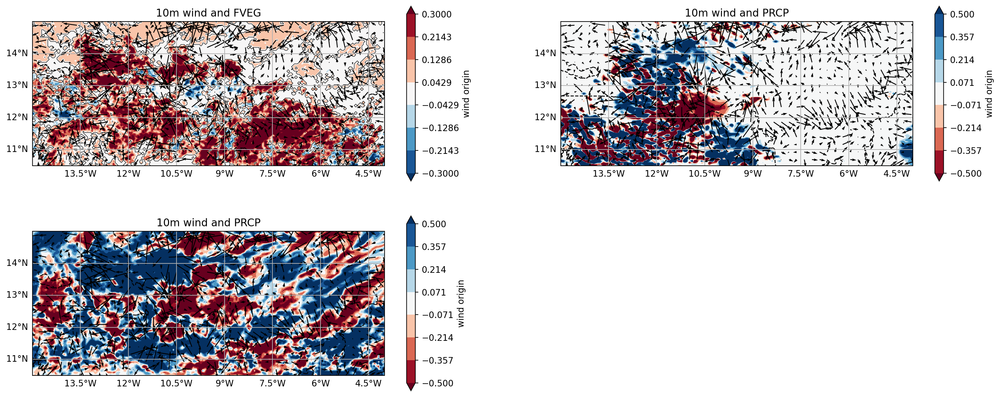

In [71]:
# preparation of wind vector data in plot
st=5
sarrow = 5

time_id = 6

xquiv = diff.lon[sarrow::st, sarrow::st]
yquiv = diff.lat[sarrow::st, sarrow::st]

uu = (ucur.isel(time=time_id))[sarrow::st, sarrow::st]
vv = (vcur.isel(time=time_id))[sarrow::st, sarrow::st]

f = plt.figure(figsize=(20,8), dpi=200)

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
data2=diff['FVEG'].isel(time=time_id)
data=diff['FVEG'].isel(time=time_id)
contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

ax.set_extent([-15, -4, 10.5, 15]) 
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}

draw_map(ax, data, diff.lon, diff.lat, title='10m wind and FVEG', quiver=qin, levels=np.linspace(-0.3,0.3,8), cbar_label='wind origin', cmap='RdBu_r', extend='both', contour=contour)

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
data=diff['PRCP'].isel(time=time_id)
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}
draw_map(ax, data, diff.lon, diff.lat, title='10m wind and PRCP', quiver=qin, levels=np.linspace(-0.5,0.5,8), cbar_label='wind origin', cmap='RdBu', extend='both')
ax.set_extent([-15, -4, 10.5, 15]) 

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
data=diff['Q2'].isel(time=time_id)*1000
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}
draw_map(ax, data, diff.lon, diff.lat, title='10m wind and PRCP', quiver=qin, levels=np.linspace(-0.5,0.5,8), cbar_label='wind origin', cmap='RdBu', extend='both')
ax.set_extent([-15, -4, 10.5, 15]) 


/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right at

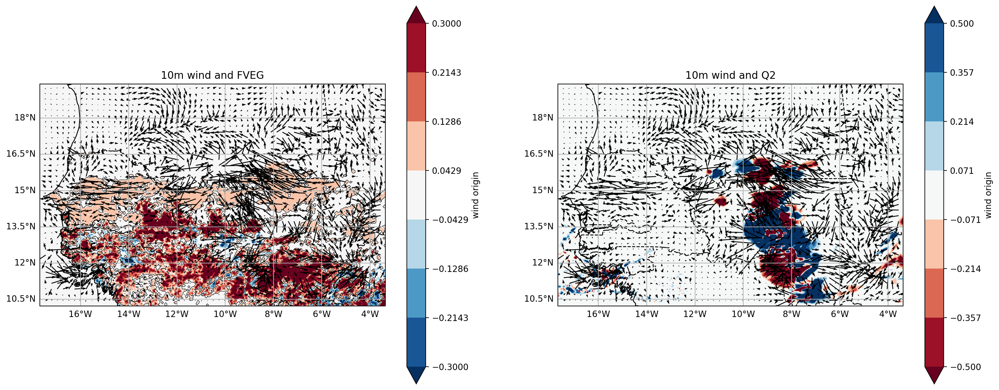

In [62]:
# preparation of wind vector data in plot
st=5
sarrow = 5

time_id = 4

xquiv = diff.lon[sarrow::st, sarrow::st]
yquiv = diff.lat[sarrow::st, sarrow::st]

uu = (ucur.isel(time=time_id))[sarrow::st, sarrow::st]
vv = (vcur.isel(time=time_id))[sarrow::st, sarrow::st]

f = plt.figure(figsize=(20,8), dpi=200)

ax = f.add_subplot(121, projection=ccrs.PlateCarree())
data2=diff['FVEG'].isel(time=time_id)
data=diff['FVEG'].isel(time=time_id)
contour = {'data' : data2, 'x' : lon, 'y' : lat, 'levels' : [-50,0], 'cmap' : 'Greys'}

qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}

draw_map(ax, data, diff.lon, diff.lat, title='10m wind and FVEG', quiver=qin, levels=np.linspace(-0.3,0.3,8), cbar_label='wind origin', cmap='RdBu_r', extend='both', contour=contour)

ax = f.add_subplot(122, projection=ccrs.PlateCarree())

data=diff['PRCP'].isel(time=time_id)#*1000

qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : 50}

draw_map(ax, data, diff.lon, diff.lat, title='10m wind and Q2', quiver=qin, levels=np.linspace(-0.5,0.5,8), cbar_label='wind origin', cmap='RdBu', extend='both')

In [79]:
pos_veg = np.where(diff['FVEG'].isel(time=1)>0.3)
neg_veg = np.where(diff['FVEG'].isel(time=1)<0)


In [119]:
diff

<xarray.Dataset>
Dimensions:      (south_north: 200, west_east: 300, time: 8, bottom_top: 44,
                  soil_layers: 3)
Coordinates:
    lat          (south_north, west_east) float32 10.22 10.22 ... 19.41 19.41
    lon          (south_north, west_east) float32 -17.68 -17.63 ... -3.369
  * west_east    (west_east) float64 -1.742e+06 -1.738e+06 ... -2.475e+05
  * south_north  (south_north) float64 1.073e+06 1.078e+06 ... 2.068e+06
  * time         (time) int64 0 3 6 9 12 15 18 21
Dimensions without coordinates: bottom_top, soil_layers
Data variables: (12/48)
    ALBEDO       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LH           (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    HFX          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    OLR          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    PBLH         (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    PSFC         (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    ...           ...
    SHDMIN       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    VEGFRA       (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LANDMASK     (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    LU_INDEX     (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    IVGTYP       (time, south_north, west_east) float64 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>
    HGT          (time, south_north, west_east) float32 dask.array<chunksize=(1, 200, 300), meta=np.ndarray>

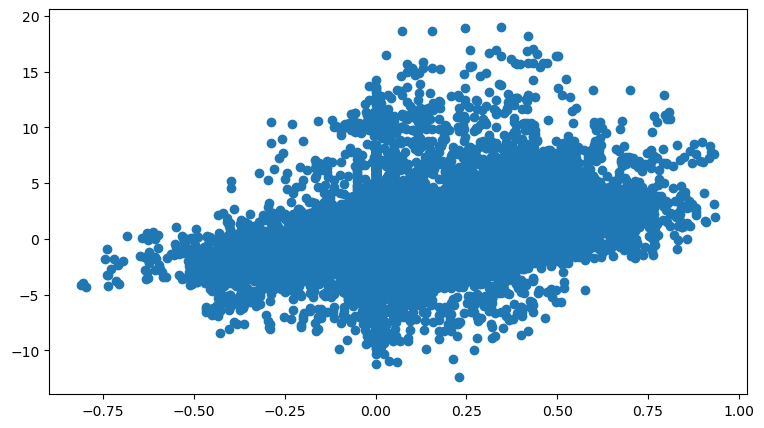

In [183]:
time_id = 4
f= plt.figure(figsize=(9,5))
ax = f.add_subplot(111)
plt.scatter(diff['FVEG'].where((diff['time.hour'] >9) & (diff['time.hour'] <15)), diff['T2'].where((diff['time.hour'] >9) & (diff['time.hour'] <15)))
#plt.scatter(diff['FVEG'].isel(time=time_id), diff['PRCP'].isel(time=time_id))

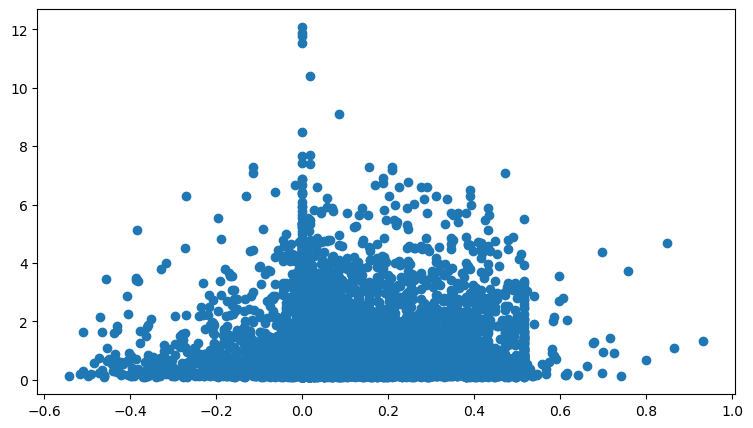

In [115]:
time_id = 4
f= plt.figure(figsize=(9,5))
ax = f.add_subplot(111)
dat_day = diff.where((diff['time'] >12) & (diff['time'] <21))
dat_night = diff.where((diff['time'] <6) & (diff['time'] >21))
plt.scatter(dat_day['FVEG'].where(dat_day['PRCP']>0.1), dat_day['PRCP'].where(dat_day['PRCP']>0.1))
#plt.scatter(diff['FVEG'].isel(time=time_id), diff['PRCP'].isel(time=time_id))

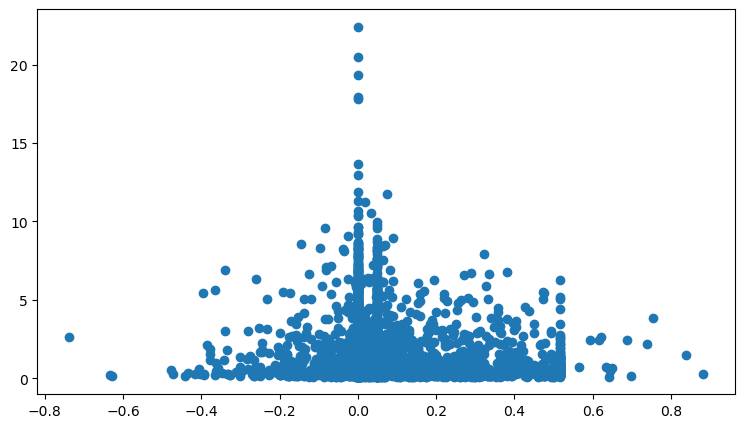

In [120]:
time_id = 4
f= plt.figure(figsize=(9,5))
ax = f.add_subplot(111)
dat_day = diff.where((diff['time'] >12) & (diff['time'] <21))
dat_night = diff.where((diff['time'] <6))
plt.scatter(dat_night['FVEG'].where(dat_night['PRCP']>0.1), dat_night['PRCP'].where(dat_night['PRCP']>0.1))
#plt.scatter(diff['FVEG'].isel(time=time_id), diff['PRCP'].isel(time=time_id))

In [99]:
def var2_binning_mean(xvar, yvar, xbins):
    """
    :param xvar: xvar of the 2dhist
    :param yvar: yvar of the 2d hist
    :param xbins: bins to use for the xvar
    :param ybins: bins to use for the yvar
    :param varlist: dictionary of variables to put into histogram
    :param varpick: list of variables in dic to calculate
    :return:
    """
    outdic = {}
    outdic['y'] = []
    outdic['ycount'] = []
    outdic['ystd'] = []


    for issh, shl in enumerate(xbins[0:-1]):

        mask = (xvar > shl) & (xvar <= xbins[issh + 1])

        #outdic['y'].append(np.nanmean(yvar[mask]))
        #print(shl)

        try:
            #outdic['y'].append(np.percentile(yvar[mask],95))
            #outdic['y'].append(np.median(yvar[mask]))
            #ipdb.set_trace()
            outdic['y'].append(np.nanmean(yvar[mask]))
            outdic['ystd'].append(np.nanstd(yvar[mask]))
            outdic['ycount'].append(np.nansum(np.isfinite(yvar[mask])))
            #ipdb.set_trace()

        except:
            # outdic['y'].append(np.nan)
            # outdic['ystd'].append(np.nan)
            # outdic['ycount'].append(np.nan)

            outdic['y'].append(0)
            outdic['ystd'].append(0)
            outdic['ycount'].append(0)

        #ipdb.set_trace()

    outdic['xbins'] = (np.round(xbins[0:-1]+((xbins[1::]-xbins[0:-1])/2),2))


    return outdic

In [319]:
dat_day = diff.where((diff['time.hour'] >9) & (diff['time.hour'] <18))
dat_night = diff.where((diff['time.hour'] <6) | (diff['time.hour'] >21))


rain = np.repeat(dat_day['PRCP'].mean('time').values[np.newaxis,:,:], 24, axis=0)

ws = np.sqrt(dat_day['U10'].values**2+dat_day['V10'].values**2)

outdic = var2_binning_mean(dat_day['FVEG'].where((rain>0.1)).values, dat_day['PRCP'].where((rain>0.1)).values, np.linspace(-0.6,0.6,10))  #where(dat_day['PRCP']>0.1) .isel(bottom_top=4).values
outdic2 = var2_binning_mean(dat_day['FVEG'].where((rain>0.1)).values, dat_day['T2'].where((rain>0.1)).values, np.linspace(-0.6,0.6,10))
outdic3 = var2_binning_mean(dat_night['FVEG'].where((rain>0.1)).values, dat_night['T2'].where((rain>0.1)).values, np.linspace(-0.6,0.6,10))

In [320]:
dat_day11 = diff11.where((diff11['time.hour'] >9) & (diff11['time.hour'] <18))
dat_night11 = diff11.where((diff11['time.hour'] <6) | (diff11['time.hour'] >21))

rain11 = np.repeat(dat_day11['PRCP'].mean('time').values[np.newaxis,:,:], 24, axis=0)

outdic_11 = var2_binning_mean(dat_day11['FVEG'].where((rain11>0.1)).values, dat_day11['PRCP'].where((rain11>0.1)).values, np.linspace(-0.6,0.6,10))
outdic2_11 = var2_binning_mean(dat_day11['FVEG'].where((rain11>0.1)).values, dat_day11['T2'].where((rain11>0.1)).values, np.linspace(-0.6,0.6,10))
outdic3_11 = var2_binning_mean(dat_night11['FVEG'].where((rain11>0.1)).values, dat_night11['T2'].where((rain11>0.1)).values, np.linspace(-0.6,0.6,10))

In [321]:
dat_day11

<xarray.Dataset>
Dimensions:      (time: 24, south_north: 200, west_east: 300, bottom_top: 44,
                  soil_layers: 3)
Coordinates:
    lat          (south_north, west_east) float32 10.22 10.22 ... 19.41 19.41
    lon          (south_north, west_east) float32 -17.68 -17.63 ... -3.369
    xtime        (time) datetime64[ns] dask.array<chunksize=(8,), meta=np.ndarray>
  * time         (time) datetime64[ns] 2011-07-01 ... 2011-07-03T21:00:00
  * west_east    (west_east) float64 -1.742e+06 -1.738e+06 ... -2.475e+05
  * south_north  (south_north) float64 1.073e+06 1.078e+06 ... 2.068e+06
Dimensions without coordinates: bottom_top, soil_layers
Data variables: (12/48)
    ALBEDO       (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    LH           (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    HFX          (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    OLR          (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    PBLH         (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    PSFC         (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    ...           ...
    SHDMIN       (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    VEGFRA       (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    LANDMASK     (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    LU_INDEX     (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    IVGTYP       (time, south_north, west_east) float64 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>
    HGT          (time, south_north, west_east) float32 dask.array<chunksize=(8, 200, 300), meta=np.ndarray>

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


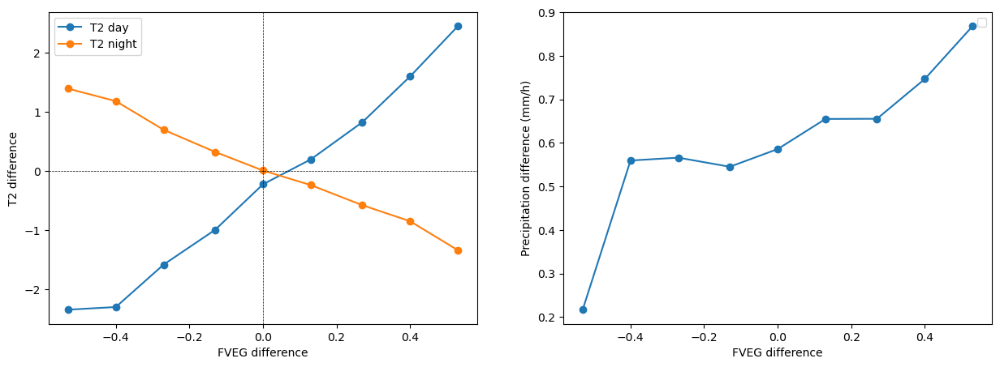

In [317]:
f = plt.figure(figsize=(15,5))
ax = f.add_subplot(121)
plt.plot(outdic2['xbins'], outdic2['y'], label='T2 day', marker='o')
plt.plot(outdic3['xbins'], outdic3['y'], label='T2 night', marker='o')
ax.set_xlabel('FVEG difference')
ax.set_ylabel('T2 difference')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.axvline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.legend()

ax = f.add_subplot(122)
plt.plot(outdic['xbins'], outdic['y'], marker='o')
ax.set_xlabel('FVEG difference')
ax.set_ylabel('Precipitation difference (mm/h)')
ax.legend()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


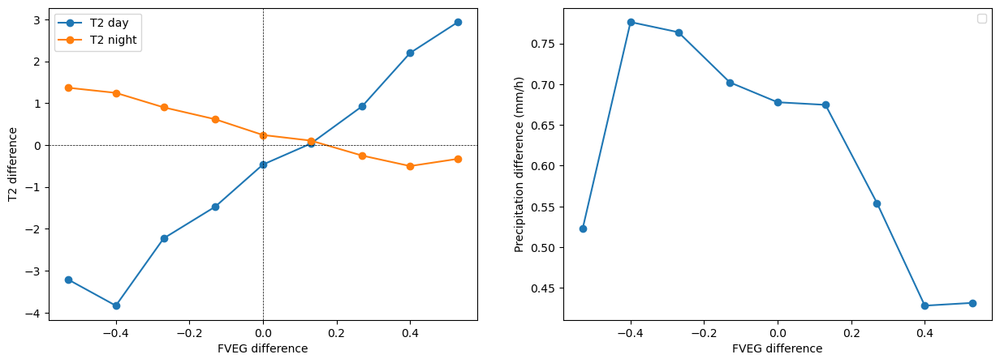

In [318]:
f = plt.figure(figsize=(15,5))
ax = f.add_subplot(121)
plt.plot(outdic2_11['xbins'], outdic2_11['y'], label='T2 day', marker='o')
plt.plot(outdic3_11['xbins'], outdic3_11['y'], label='T2 night', marker='o')
ax.set_xlabel('FVEG difference')
ax.set_ylabel('T2 difference')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.axvline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.legend()

ax = f.add_subplot(122)
plt.plot(outdic_11['xbins'], outdic_11['y'], marker='o')
ax.set_xlabel('FVEG difference')
ax.set_ylabel('Precipitation difference (mm/h)')
ax.legend()

(-1.0, 1.0)

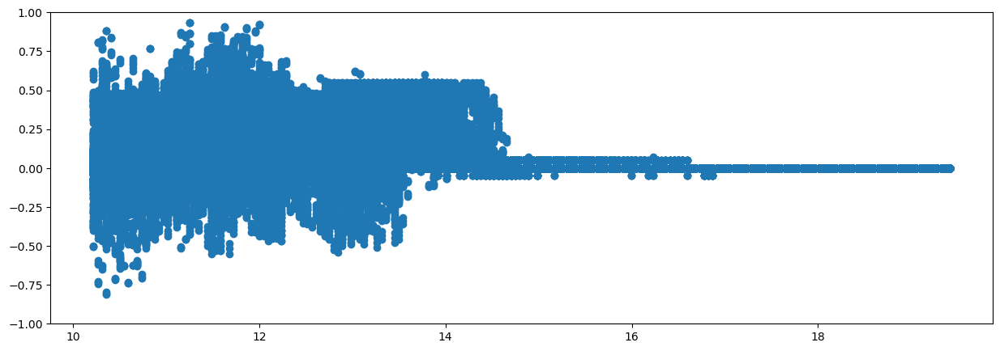

In [217]:
f = plt.figure(figsize=(15,5))

plt.scatter(np.repeat(dat_day.lat.values[np.newaxis,:,:], 24, axis=0), dat_day['FVEG'].values)
plt.ylim(-1,1)

(-1.0, 1.0)

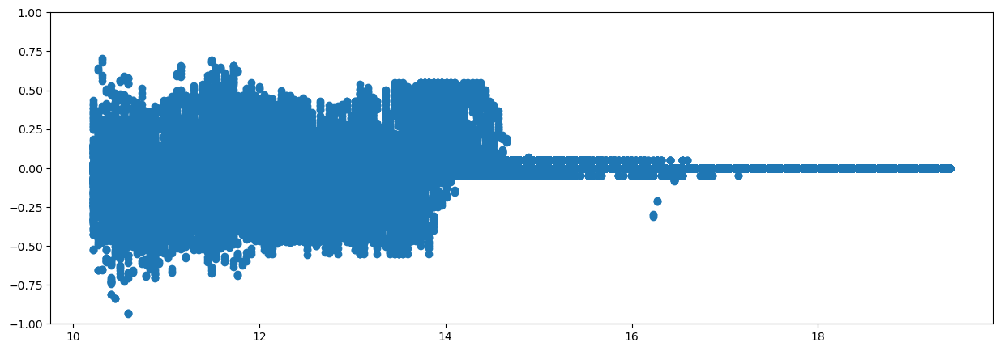

In [218]:
f = plt.figure(figsize=(15,5))

plt.scatter(np.repeat(dat_day11.lat.values[np.newaxis,:,:], 24, axis=0), dat_day11['FVEG'].values)
plt.ylim(-1,1)

In [307]:
np.repeat(dat_day11['PRCP'].mean('time').values[np.newaxis,:,:], 24, axis=0).shape

(24, 200, 300)